# Лабораторная работа №8: численные методы решения уравнений в частных производных


#### Выполнил Ходин Иван, 427 группа

## Пример 1:

$$
\begin{cases}
\frac{\partial u}{\partial t}= a\frac{\partial ^2 u}{\partial x^2}, a>0
\\u(0,t)=0
\\u(1,t)=0
\\u(x,0)=sin(2\pi x)
\end{cases}
$$
Аналитическое решение: $$ u(x,t)=e^{-4\pi ^{2}at}sin(2\pi x) $$


## Теория: 

Рассмотрим задачу о распространении тепла на отрезке в случае простейших краевых условий 1-го рода
$$
u_{t}=a^{2}u_{xx}+f(x,t), 0<x<l, t>0
$$
Начальные условия:
$$
u(x,0)=\mu_{1}(x) \equiv \mu(x)
$$
однородные краевые условия:
$$
u(0,t)=\mu_{2}(t)\equiv 0; u(l, t)= \mu_{3} \equiv 0, t \underline{>}0
$$

Введём в области
$$
\overline{D}= [0;l] \times [0;T]
$$
сетку
$$
\Omega= \omega_{h} \times \omega_{tau}
$$
где
$$
\omega_{h}=\big\{ 0= x_{0} < x_{1} < ... < x_{N} = l \\
x_{n} = x_{0} + nh, h= \frac {x_{N}-x_{0}} {N} \big\}
$$
и
$$
\omega_{\tau}=\big\{ 0=t_{0}<t_{1}<...< t_{M}=T \\
t_{m}= t_{0}+ m\tau, \tau=\frac{T-t_{0}}{M} \big\}
$$

Рассмотрим сеточную функцию $$ y(x_n;t_m)= y^m_n=y $$ на сетке $$ \Omega \equiv \omega_{h,t} $$

После некоторых преобразований получаем разностную схему $$
\begin{cases} \frac{1}{\tau}(y^m+1_n-y^m_n)=a^2\Delta_h \big\{ \sigma \widehat{y}+ (1-\sigma)y \big\} + \Phi^m_n; (x_n, t_m) \in \omega_{h,t} \\
y^0_n=\chi_n; \\
y^m_0= y^m_N= 0 = \chi^m_{0,N} \end{cases} \\ \Delta_h y^m_n= \frac{1}{h^2}(y^m_{n+1}-2y^m_n+y^m_{n-1})
$$ 

In [25]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib
from IPython.display import Image
matplotlib.rcParams['animation.embed_limit'] = 10*1024*1024

In [26]:
h = 0.01
a = 1

q = h**2/(2*a)

x = np.arange(0, 1 + h, h)
t = np.arange(0, 0.05 + q, q)

In [27]:
U1 = np.zeros((len(t), len(x)))

U1[0, :] = np.sin(2 * np.pi * x)

for i in range(1, len(t)):
    for j in range(1, len(x) - 1):
        U1[i, j] = a * q / (h**2) * (U1[i-1, j-1] + U1[i-1, j+1]) + (1 - 2 * a * q / (h**2)) * U1[i-1, j]

In [28]:
# Аналитическое решение 

W1 = np.zeros_like(U1)

for i in range(len(t)):
    for j in range(len(x) - 1):
        W1[i, j] = np.exp(-4 * a * np.pi**2 * t[i]) * np.sin(2 * np.pi * x[j])

In [29]:
r1 = np.zeros_like(U1)

for i in range(len(t)):
    for j in range(len(x)):
        r1[i, j] = abs(W1[i, j] - U1[i, j])
        
print("\n Модуль невязки =", np.linalg.norm(r1), "\n")


 Модуль невязки = 0.0455106810825616 




 График невязки: 



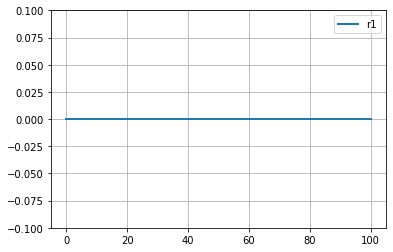

In [30]:
print("\n График невязки: \n")
plt.plot(r1[0,:], lw = 2,  label='r1')
plt.grid()
plt.legend()
plt.ylim(-0.1,0.1)
plt.show()

In [31]:
fig, ax = plt.subplots()
xdata, ydata = [], []
ln, = plt.plot([], [], 'green', lw=2)
plt.grid()

def init():
    ax.set_xlim(0, 1)
    ax.set_ylim(-1.1, 1.1)
    return ln,

def update(frame):
    ln.set_data(x, U1[frame])
    return ln,

anime = FuncAnimation(fig, update, frames=np.arange(0, len(t)-100, 1), interval = 5, init_func=init, blit=True)

plt.close()

In [32]:
HTML(anime.to_jshtml())

## Пример 2:

Уравнение гиперболического типа 

$$
\begin{cases}
\frac{\partial ^2 u}{\partial t^2} = a^2\frac{\partial ^2 u}{\partial y^2}, a^2 > 0
\\u(0,t) = - sin(at)
\\u(\pi,y) = sin(at)
\\u(x,0) = sin(x)
\\ut(x,0) = -acos(x)
\end{cases}
$$

Аналитическое решение: $$ u(x,t) = sin(x - at) $$

## Теория: 

Рассмотрим задачу для уравнения колебаний на отрезке с краевыми условиями 1-го рода (задачу Дирихле)
$$ 
u_{tt}=a^{2}u_{xx}+f(x,t), 0<x<l, t>0 
$$
Начальные условия:
$$
u(x,0)=\mu_{1}(x), u_{t}(x,0)=\mu_{2}(x), t = 0, x \in [0,l] 
$$
краевые условия 1-го рода:
$$
u(0,t)=\mu_{3}(t)\equiv 0; u(l, t)= \mu_{4} \equiv 0, t \geq 0
$$

После некоторых преобразований получим краевую схему:
$$
\frac{y^{m+1}_{n} - 2y + y^{m-1}_{n}}{\tau} = a^2 \frac{y_{n+1} - 2y_{n} + y_{n-1}}{h^2} + \varphi^{m}_{n}
$$
краевые условия: 
$$ 
y^{m}_{0} = \chi^{m}_{3} = \mu_{3}(t_{m}) \equiv 0;  y^{m}_{n} = \chi^{m}_{4} = \mu_{4}(t_{m}) \equiv 0;
$$
начальные условия: 
$$
y^{0}_{n} = \chi_{1}(x_{n}) = \mu_{1}(x_{n})
$$

In [9]:
h = np.pi / 100
a = 2 

q = h / (5 * a)

x = np.arange(0, np.pi + h, h)
t = np.arange(0, 1 + q, q)

In [10]:
U2 = np.zeros((len(t), len(x)))

U2[:, 0] = -np.sin(a * t)
U2[:, -1] = np.sin(a * t)

U2[0, :] = np.sin(x)
U2[1, :] = U2[0, :] + q * (-a * np.cos(x)) + q**2 / 2 * (-np.sin(x))

lmd = ((a * q)**2) / (h**2)

for i in range(2, len(t)):
    for j in range(1, len(x) - 1):
        U2[i, j] = 2 * (1 - lmd) * U2[i-1, j] + lmd * (U2[i-1, j+1] + U2[i-1, j-1]) - U2[i-2, j]

In [11]:
# Аналитическое решение

W2 = np.zeros_like(U2)

for i in range(len(t)):
    for j in range(len(x)):
        W2[i, j] = np.sin(x[j] - a * t[i])

In [12]:
r2 = np.zeros_like(U2)

for i in range(len(t)):
    for j in range(len(x)):
        r2[i, j] = abs(W2[i, j] - U2[i, j])
        
print("\n Модуль невязки =", np.linalg.norm(r2), "\n")


 Модуль невязки = 0.23494615187158532 




 График невязки: 



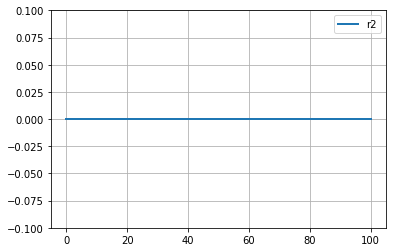

In [13]:
print("\n График невязки: \n")
plt.plot(r2[0,:], lw = 2,  label='r2')
plt.grid()
plt.legend()
plt.ylim(-0.1,0.1)
plt.show()

In [14]:
fig, ax = plt.subplots()
xdata, ydata = [], []
ln, = plt.plot([], [], 'blue', lw = 2)
plt.grid()

def init():
    ax.set_xlim(0, np.pi)
    ax.set_ylim(-1.5, 1.5)
    return ln,

def update(frame):
    ln.set_data(x, U2[frame])
    return ln,

anime = FuncAnimation(fig, update, frames = np.arange(0, len(t), 1), interval = 5, init_func=init, blit=True)

plt.close()

In [15]:
HTML(anime.to_jshtml())

## Пример 3: 

Уравнение эллиптического типа 

$$
\begin{cases}
\frac{\partial ^2 u}{\partial x^2} + \frac{\partial ^2 u}{\partial y^2} = 0
\\u(0,y) = y
\\u(1,y) = 1 + y
\\u(x,0) = x
\\u(x,1) = 1 + x
\end{cases}
$$

Аналитическое решение: $$ u(x,t) = x + y $$

## Теория:

Рассмотрим задачу о распределении тепла в прямоугольной области:
$$
\begin{cases} u_l=a^2(u_{x_{1}x_1} + u_{x_{2}x_2})+ f(x_1, x_2, t), 0<x_1<l_1, 0< x_2< l_2, 0<l
\\ u|_Г= \mu_Г(l)
\\ u|_{t=0}= \mu(x1, x2) \end{cases}
$$

Рассмотрим в 
$$ 
\overline{D} 
$$ 
равномерную сетку:
$$
\overline{\omega_{h_1, h_2, \tau}}= \big\{ (x_{1n}, x_{2k}, l_m): x1_{1n}= nh_1; n= \overline{1,N}; h_1=\frac{l_1}{N} \\
x_{2k}= kh_2; k= \overline{1,K}; h_1=\frac{l_2}{K} \\
t_m= m\tau; m= \overline{1,M}; \tau=\frac{T}{M} \big\}
$$

После некоторых преобразований получим аппроксимацию основного уравнения задачи:
$$
\frac{1}{\tau}(\widehat y_{n,k}- y_{n,k})= a^2(\Delta_1 + \Delta_2)[\sigma \widehat y_{n,k} + (1- \sigma)y_{n,k} ] + \Phi^m_{n,k} \\
\Delta_2 y=\frac{1}{h^2_2}(y_{n,k+1}- 2y_{n,k} + y_{n,k-1}) \\
\Delta_1 y=\frac{1}{h^2_1}(y_{n+1,k}- 2y_{n,k} + y_{n-1,k})
$$

In [16]:
h = 0.05

x = np.arange(0, 1 + h, h)

y = np.arange(0, 1 + h, h)

In [17]:
U3 = np.zeros((len(y), len(x)))

U3[:, 0] = y
U3[:, -1] = 1 + y

U3[0, :] = x
U3[1, :] = U3[0, :] + h
U3[-1, :] = 1 + x

for i in range(2, len(y) - 1):
    for j in range(1, len(x) - 1):
        U3[i, j] = 4 * U3[i-1, j] - U3[i-1, j+1] - U3[i-1, j-1] - U3[i-2, j]

In [18]:
# Аналитическое решение

W3 = np.zeros_like(U3)

for i in range(len(y)):
    for j in range(len(x)):
        W3[i, j] = x[j] + y[i]

In [19]:
r3 = np.zeros_like(U3)

for i in range(len(y)):
    for j in range(len(x)):
        r3[i, j] = abs(W3[i, j] - U3[i, j])
        
print("\n Модуль невязки =", np.linalg.norm(r3), "\n")


 Модуль невязки = 0.0013484138788068304 



In [21]:
fig, ax = plt.subplots()
xdata, ydata = [], []
ln, = plt.plot([], [], 'red', lw=2)
plt.grid()

def init():
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 2)
    return ln,

def update(frame):
    ln.set_data(x, U3[frame])
    return ln,

anime = FuncAnimation(fig, update, frames=np.arange(0, len(y), 1), interval = 75, init_func = init, blit = True)

plt.close()

In [22]:
HTML(anime.to_jshtml())